# Data Analysis Backup

### Loading Packages

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal as sg
import plotly.graph_objects as go
from plotly.subplots import make_subplots

### Color Cycle

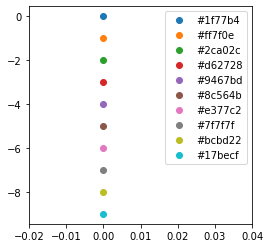

In [2]:
colorcycle = [u'#1f77b4', u'#ff7f0e', u'#2ca02c', u'#d62728', u'#9467bd', 
              u'#8c564b', u'#e377c2', u'#7f7f7f', u'#bcbd22', u'#17becf']

x = 0
y = -np.linspace(0, 9, len(colorcycle))

plt.figure(figsize = (4,4))
for i in range(len(colorcycle)):
    plt.plot(x, y[i], 'o', color = '%s' % colorcycle[i], label = '%s' % colorcycle[i])
plt.xlim(-0.02, 0.04)
plt.legend()
plt.show()

### Functions

#### `importsortLT295Chip3_BF_20230927`

In [3]:
def importsortLT295Chip3_BF_20230927(filename, s21dd):
    dataset = '/Users/gabriellomans/Desktop/Uni/TUD/BEP/Code/LT295Chip3_BF_20230927/%s' % filename
    data = np.genfromtxt(dataset,
                        names = True,
                        dtype = None,
                        delimiter = '')
    N = len(data)
    f,s21,dd = np.zeros(N),np.zeros(N),np.zeros(N)
    for i in range(N):
        f[i],s21[i],dd[i] = data[i][0],data[i][1],data[i][2]
    
    flist,s21list,ddlist = [],[],[]
    flist.append('f (GHz)')
    flist.append(f)
    s21list.append('$|S_{21}|$ (dB)')
    s21list.append(s21)
    ddlist.append('Double Derivative')
    ddlist.append(dd)
    
    if s21dd == 1:
        return flist,s21list,filename
    elif s21dd == 2:
        return flist,ddlist,filename

#### `plot_s21_dd_LT295Chip3_BF_20230927`

In [4]:
def plot_s21_dd_LT295Chip3_BF_20230927(filename, m, dm, vline, dipplot):
    plots21 = importsortLT295Chip3_BF_20230927(filename,1)
    plotdd = importsortLT295Chip3_BF_20230927(filename,2)
    
    # Plot
    fig,axs = plt.subplots(2,1,sharex=True,figsize=(10,7))
    fig.subplots_adjust(hspace=0)
    axs[0].plot(plots21[0][1], plots21[1][1])
    axs[0].set_xlabel('%s' % plots21[0][0])
    axs[0].set_ylabel('%s' % plots21[1][0])
    axs[0].tick_params(top = False, labeltop = False, bottom = False, labelbottom = False)
    axs[1].plot(plotdd[0][1], plotdd[1][1])
    axs[1].set_xlabel('%s' % plotdd[0][0])
    axs[1].set_ylabel('%s' % plotdd[1][0])
    axs[1].tick_params(top = False, labeltop = False, bottom = True, labelbottom = True)
    
    # Decide centering
    xbot = m - 0.5*dm
    xtop = m + 0.5*dm
    
    # Decide dip detection
    dips1,_ = sg.find_peaks(-plots21[1][1], prominence = 5)
    Ndips1 = len(dips1)
        # finding drips of S21
    peaks2,_ = sg.find_peaks(plotdd[1][1], prominence = 5)
    dips2,_ = sg.find_peaks(-plotdd[1][1], prominence = 3)
    Npeaks2 = len(peaks2)
    Ndips2 = len(dips2)
        # finding dips and peaks of double derivative 
    if dipplot == 1:
        axs[0].plot(plots21[0][1][dips1], plots21[1][1][dips1], 'o', label = '%s dips' % Ndips1)
        axs[1].plot(plotdd[0][1][peaks2], plotdd[1][1][peaks2], 'o', label = '%s peaks' % Npeaks2)
        axs[1].plot(plotdd[0][1][dips2], plotdd[1][1][dips2], 'o', label = '%s dips' % Ndips2)
        axs[0].legend()
        axs[1].legend()
    elif dipplot == 0:
        None
    
    # Decide plotting vline
    if vline != 0:
        axs[0].axvline(vline,c='r')
        axs[1].axvline(vline,c='r')
    else:
        None

    axs[0].title.set_text('Plot %s' % filename)
    plt.show()

#### `importsort_S21s2`

In [5]:
def importsort_S21s2(filename, s21dd):
    dataset = '/Users/gabriellomans/Desktop/Uni/TUD/BEP/Code/spatial-mapping/S21s/%s' % filename
    data = np.genfromtxt(dataset,
                        names = True,
                        dtype = None,
                        delimiter = '')
    N = len(data)
    f,s21,dd = np.zeros(N),np.zeros(N),np.zeros(N)
    for i in range(N):
        f[i],s21[i],dd[i] = data[i][0],data[i][1],data[i][2]
    
    flist,s21list,ddlist = [],[],[]
    flist.append('f (GHz)')
    flist.append(f)
    s21list.append('$|S_{21}|$ (dB)')
    s21list.append(s21)
    ddlist.append('Double Derivative')
    ddlist.append(dd)
    
    if s21dd == 1:
        return flist,s21list,filename
    elif s21dd == 2:
        return flist,ddlist,filename

#### `plotone`

In [6]:
def plotone(plots, m, dm, vline, peakdip, par):
    plt.figure(figsize = (15,5))
    
    if peakdip < 0:
        plt.plot(plots[0][1], plots[1][1], label = '%s' % plots[2])
        
        dips,_ = sg.find_peaks(-plots[1][1], distance = par[0], prominence = par[1])
        plt.plot(plots[0][1][dips], plots[1][1][dips], 'o', label = '%s dips' % len(dips))
    elif peakdip > 0:
        plt.plot(plots[0][1], plots[1][1], label = '%s' % plots[2])
        
        peaks,_ = sg.find_peaks(plots[1][1], distance = par[0], prominence = par[1])
        plt.plot(plots[0][1][peaks], plots[1][1][peaks], 'o', label = '%s peaks' % len(peaks))
    elif peakdip == 0:
        plt.plot(plots[0][1], plots[1][1], label = '%s' % plots[2])
        
    xbot = m - 0.5*dm
    xtop = m + 0.5*dm
    
    if vline != 0:
        for i in range(len(vline)):
            plt.axvline(vline[i],c='r')
    else:
        None
    
    plt.xlabel('%s' % plots[0][0])
    plt.ylabel('%s' % plots[1][0])
    plt.tick_params(top = False, labeltop = False, bottom = True, labelbottom = True)
    plt.xlim(xbot,xtop)
    plt.title('Plot %s' % plots[2])
    plt.legend()
    plt.show()

#### `plotcompare`

In [7]:
# Plotting multiple datafiles
def plotcompare(plots, m, dm, vline, peakdip, par):
    plt.figure(figsize = (15,5))
    
    if peakdip == -1:
        for i in range(len(plots)):
            plt.plot(plots[i][0][1], plots[i][1][1], label = '%s' % plots[i][2])
            
            dips,_ = sg.find_peaks(-plots[i][1][1], distance = par[0], prominence = par[1])
            plt.plot(plots[i][0][1][dips], 
                     plots[i][1][1][dips], 'o', label = '%s dips' % len(dips))
    elif peakdip == 1:
        for i in range(len(plots)):
            plt.plot(plots[i][0][1], plots[i][1][1], label = '%s' % plots[i][2])
            
            peaks,_ = sg.find_peaks(plots[i][1][1], distance = par[0], prominence = par[1])
            plt.plot(plots[i][0][1][peaks], 
                     plots[i][1][1][peaks], 'o', label = '%s dips' % len(peaks))
    elif peakdip == 2:
        for i in range(len(plots)):
            plt.plot(plots[i][0][1], plots[i][1][1], label = '%s' % plots[i][2])
            
            dips,_ = sg.find_peaks(-plots[i][1][1], distance = par[0], prominence = par[1])
            plt.plot(plots[i][0][1][dips], 
                     plots[i][1][1][dips], 'o', label = '%s dips' % len(dips))
            
            peaks,_ = sg.find_peaks(plots[i][1][1], distance = par[0], prominence = par[1])
            plt.plot(plots[i][0][1][peaks], 
                     plots[i][1][1][peaks], 'o', label = '%s dips' % len(peaks))
    elif peakdip == 0:
        for i in range(len(plots)):
            plt.plot(plots[i][0][1], plots[i][1][1], label = '%s' % plots[i][2])
        
    if vline != 0:
        for i in range(len(vline)):
            plt.axvline(vline[i],c='r')
    else:
        None
    
    xbot = m - 0.5*dm
    xtop = m + 0.5*dm
    
    plt.xlabel('%s' % plots[0][0][0])
    plt.ylabel('%s' % plots[0][1][0])
    plt.tick_params(top = False, labeltop = False, bottom = True, labelbottom = True)
    plt.xlim(xbot,xtop)
    plt.title('Plot comparison')
    plt.legend()
    plt.show()

#### `plotsimx`

In [8]:
def plotsimx(plots, m, dm, vline):
    Nplots = len(plots)
    fig,axs = plt.subplots(len(plots),1,sharex=True,figsize=(15,3*Nplots))
    fig.subplots_adjust(hspace=0)

    xbot = m - 0.5*dm
    xtop = m + 0.5*dm
    
    for i in range(Nplots):
        axs[i].plot(plots[i][0][1], plots[i][1][1], label = '%s' % plots[i][2]) 
        
        if vline != 0:
            axs[i].axvline(vline,c='r')
        else:
            None
        
        axs[i].set_xlim(xbot,xtop)
        axs[i].set_xlabel('%s' % plots[i][0][0])
        axs[i].set_ylabel('%s' % plots[i][1][0])
        axs[i].tick_params(top = False, labeltop = False, bottom = False, labelbottom = False)
        axs[i].legend()
        
    axs[-1].tick_params(top = False, labeltop = False, bottom = True, labelbottom = True)
    plt.show()

#### `plotdiffs21`

In [9]:
def plotdiffs21(plot1, plot2):
    s21diff = []
    s21diff.append(plot1[1][0])
    s21diff.append(plot1[1][1] - plot2[1][1])
    
    diff = []
    diff.append(plot1[0])
    diff.append(s21diff)
    diff.append('Diff %s and %s' % (plot1[2], plot2[2]))
    return diff

#### `sma`

In [10]:
def sma(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

#### `sma_plot`

In [11]:
def sma_plot(plot, w):
    x = []
    x.append(plot[0][0])
    x.append(sma(plot[0][1], w))
    
    y = []
    y.append(plot[1][0])
    y.append(sma(plot[1][1], w))
    
    title = plot[2]
    return [x, y, title]

#### `importsortS21_6102023`

In [12]:
def importsortS21_6102023(filename, s21dd):
    dataset = '/Users/gabriellomans/Desktop/Uni/TUD/BEP/Code/spatial-mapping/S21s/S21s_6102023/%s' % filename
    data = np.genfromtxt(dataset,
                        names = True,
                        dtype = None,
                        delimiter = '')
    N = len(data)
    f,s21,dd = np.zeros(N),np.zeros(N),np.zeros(N)
    for i in range(N):
        f[i],s21[i],dd[i] = data[i][0],data[i][1],data[i][2]
    
    flist,s21list,ddlist = [],[],[]
    flist.append('f (GHz)')
    flist.append(f)
    s21list.append('$|S_{21}|$ (dB)')
    s21list.append(s21)
    ddlist.append('Double Derivative')
    ddlist.append(dd)
    
    if s21dd == 1:
        return flist,s21list,filename
    elif s21dd == 2:
        return flist,ddlist,filename

#### `plotcontrol`

In [13]:
def plotcontrol(plots, m, dm, vline, peakdip, par):
    fig,axs = plt.subplots(2, 1, sharex=True, figsize=(15,8), 
                           gridspec_kw={'height_ratios': [3, 2], 'hspace': 0})
    fig.subplots_adjust(hspace=0)

    xbot = m - 0.5*dm
    xtop = m + 0.5*dm
    
    plot1 = plots[0]
    plot2 = plots[1]
    axs[0].plot(plot1[0][1], plot1[1][1], label = '%s' % plot1[2])
    axs[0].plot(plot2[0][1], plot2[1][1], label = '%s' % plot2[2])
    
    diff = plotdiffs21(plot1, plot2)
    axs[1].plot(diff[0][1], diff[1][1], label = '%s' % diff[2])
    
    if vline != 0:
        axs[0].axvline(vline,c='k')
        axs[1].axvline(vline,c='k')
    else:
        None
            
    if peakdip == 1:
        dips1,_ = sg.find_peaks(-plot1[1][1], distance = par[0], prominence = par[1])
            
        axs[0].plot(plot1[0][1][dips1], plot1[1][1][dips1], 'o', c ='r', label = '%s dips' % len(dips1))
                # The contol with dip detection is plotted
        axs[1].plot(diff[0][1][dips1], diff[1][1][dips1], 'o', c ='r')
                # Dip detection from the control is plotted with the difference
    if peakdip == 2:
        dips2,_ = sg.find_peaks(-plot2[1][1], distance = par[0], prominence = par[1])
            
        axs[0].plot(plot2[0][1][dips2], plot2[1][1][dips2], 'o', c ='b', label = '%s dips' % len(dips2))
                # The contol with dip detection is plotted
        axs[1].plot(diff[0][1][dips2], diff[1][1][dips2], 'o', c ='b')
                # Dip detection from the control is plotted with the difference
    if peakdip == 12:
        dips1,_ = sg.find_peaks(-plot1[1][1], distance = par[0], prominence = par[1])
        dips2,_ = sg.find_peaks(-plot2[1][1], distance = par[0], prominence = par[1])
        
        axs[0].plot(plot1[0][1][dips1], plot1[1][1][dips1], 'o', c ='r', label = '%s dips' % len(dips1))
        axs[0].plot(plot2[0][1][dips2], plot2[1][1][dips2], 'o', c ='b', label = '%s dips' % len(dips2))
                # The contol with dip detection is plotted
        axs[1].plot(diff[0][1][dips1], diff[1][1][dips1], 'o', c ='r')
        axs[1].plot(diff[0][1][dips2], diff[1][1][dips2], 'o', c ='b')
                # Dip detection from the control is plotted with the difference
    elif peakdip == 0:
        None
    
    axs[0].set_xlim(xbot,xtop)
    axs[0].set_ylabel('%s' % plot1[1][0])
    axs[0].tick_params(top = False, labeltop = False, bottom = False, labelbottom = False)
    axs[0].legend()
    
    axs[1].set_xlim(xbot,xtop)
    axs[1].set_xlabel('%s' % plot1[0][0])
    axs[1].set_ylabel('$\Delta$%s' % plot1[1][0])
    axs[1].tick_params(top = False, labeltop = False, bottom = True, labelbottom = True)
    axs[1].legend()

#### `find_dipindex`

In [14]:
def find_dipindex(plot, par):
    # plot: the dataset from which the dips are going to be detected 
    #   using the signal.find_peaks algorithm
    # par: [distance, prominence], the parameters of the signal.find_peaks
    #   distance: Required minimal horizontal distance (>= 1) in samples between neighbouring peaks. 
    #     Smaller peaks are removed first until the condition is fulfilled for all remaining peaks.
    #   prominence: Required prominence of peaks.
    #     The first element is always interpreted as the minimal and the second, 
    #     if supplied, as the maximal required prominence.
    dips,_ = sg.find_peaks(-plot[1][1], distance = par[0], prominence = par[1])
    
    dipindex_n = []
    dipindex = []
    for i in range(len(dips)):
        dipindex_n.append(i+1)
            # the number of dip in the dip dataset
            # thos number starts at 1 instead of 0
        dipindex.append(dips[i])
            # the pointnumber in the complete dataset at which the
            # dip is positioned
    return dipindex_n, dipindex

#### `find_DS21_max`

In [15]:
def find_DS21_max(dark, plots):
    # dark: the dataset where none of the detectors are illuminated, a "dark" measurement
    #   This dataset is the control set with which the other datasets are compared
    #   with to determine any sign of change.
    # plots: the dataset obtained from a measurement where a row/column of detectors was
    #   illuminated.
    dipindex = find_dipindex(dark, [4,2])[1]
    
    line = []
        # the coordinates of the line
    depth = []
        # the transmission difference value of the dip
        # a.k.a. the 'depth' of the dip displayed in the difference plot
    line_max = []
        # the y-coordinate of the line at which there is a
        # maximum transmission difference value
    depth_max = []
        # the maximum transmission difference value
    
    for i in range(len(dipindex)):
        n = [dipindex[i]]
        depth_list = []
        for j in range(len(plots)):
            depth_val = abs(plotdiffs21(dark,plots[j])[1][1][n][0])
            depth_list.append(depth_val)
            # Every single dip is being examined on their response to a specific
            # line coordinate, the line being the line projected on the display
            # This line can either move in the x or y direction.
            # When the line is varied in the y direction, the dip will be examined
            # based on its response to different y-coordinates of the line.
            # This story is similar for when the line is varied in the x direction.
        depth.append(depth_list)
        
        for j in range(len(depth_list)):
            if depth_list[j] == max(depth_list):
                    # finding the index of the maximum transmission difference
                line_max.append(j+1)
                    # the number of dip in the dip dataset
                    # thos number starts at 1 instead of 0
                depth_max.append(depth_list[j])
                    # saving the maximum transmission difference value 
            else:
                None
        
        line1 = np.linspace(1, len(plots), len(plots))
        line.append(line1)
                
    return line, depth, line_max, depth_max 

#### `plot_find_DS21_max`

In [16]:
def plot_find_DS21_max(dark, plots, coordinate, dipnr, savefig):
    # dark: the dataset where none of the detectors are illuminated, a "dark" measurement
    #   This dataset is the control set with which the other datasets are compared
    #   with to determine any sign of change.
    # plots: the dataset obtained from a measurement where a row/column of detectors was
    #   illuminated.
    # coordinate: the varied coordinate, x or y. This is a string and is used for axis
    #   labeling in the constructed plot.
    # dipnr: dip number in the dip dataset. By filling in an integer value in this parameter,
    #   this function allows the user to view the behavior of one dip of choice and therefore
    #   the behavior (and row/column-coordinate) of one detector.
    # savefig: value may be True (= save figure) or False (= do not save figure)
    line, DS21, line_max, DS21_max = find_DS21_max(dark, plots)
    
    dipnr_i = dipnr - 1
        # Decides which plot will be examined 
        # Since indices start at 0 and not at 1,
        # the dip number has to subtracted by 1.
    plt.figure(figsize = (10,4))
    plt.axvline(line_max[dipnr_i], c = 'grey', ls = '--')
    plt.plot(line[dipnr_i], DS21[dipnr_i])
    plt.plot(line_max[dipnr_i], DS21_max[dipnr_i], 'o', label = '$\Delta$|S$_{21}$|$_{max}$')
    plt.xlabel('%s' % coordinate)
    plt.ylabel('$\Delta$%s' % dark[1][0])
    plt.tick_params(top = False, labeltop = False, bottom = True, labelbottom = True)
    plt.legend()
    
    if savefig == True:
        plt.savefig('Dip %s DS21 to %s' % (dipnr, coordinate), format = 'eps')
    else:
        None

    plt.show()

#### `assigncoordinate`

In [17]:
def assigncoordinate(dark, plots, threshold, coordinate, stats):
    dipindex = find_dipindex(dark, [4,2])[1]
    # dark: the dataset where none of the detectors are illuminated, a "dark" measurement
    #   This dataset is the control set with which the other datasets are compared
    #   with to determine any sign of change.
    # plots: the dataset obtained from a measurement where a row/column of detectors was
    #   illuminated.
    # threshold: the lowest value of transmission difference that will allow the discovered
    #   row/column-coordinate to be added to the list of determined coordinates and taken
    #   to the last step in coordinate identification.
    # coordinate: the varied coordinate, x or y. This is a string and is used for axis
    #   labeling in the constructed plot.
    # stats: value may be True (= show overview of the number of dips per row/column-coordinate)
    #   or False (= do not show stats, simply return list of values for future analysis) 
    line, DS21, line_max, DS21_max = find_DS21_max(dark, plots)
    
    # Creating a list where the information of each dip
    # detected by the algorithm is saved
    coord_i = []
    for i in range(len(line)):
        coord1 = [i+1, 
                      # Number in dip set
                  line_max[i], 
                      # Number of row/column
                  DS21_max[i], 
                      # Value of ∆|S_21|_max
                  y0x0[0][1][dipindex[i]]
                      # Resonance frequency
                 ]
        coord_i.append(coord1)

    # Creating a list where the elements of the previous list
    # are organized according to coordinate
    coord = []        
    for i in range(len(line[0])):
        coord2 = []
        for j in range(len(line)):
            # Adding elements according to coordinate
            if coord_i[j][1] == i+1:
                # Deciding which element is saved based on 
                # the ∆|S_21|_max value being above the threshold
                if coord_i[j][2] > threshold:
                    coord2.append(coord_i[j])
                else:
                    None
            else: 
                None
        coord.append(coord2)
    
    if stats == True:
        print('Number of detectors at coordinate:')
        for i in range(len(coord)):
            print('%s = %s: %s' % (coordinate, i+1, len(coord[i])))
        print()
    else:
        return coord 

#### `match_meshgrid`

In [18]:
def match_meshgrid(N, dark, xdata, ydata, printing):
    # N: size of the spatial raster (N x N)
    # dark: the dataset where none of the detectors are illuminated, a "dark" measurement
    #   This dataset is the control set with which the other datasets are compared
    #   with to determine any sign of change.
    # xdata: the determined x-coordinates with their dip number 
    # ydata: the determined y-coordinates with their dip number
    # printing: value may be True (print the meshgrid list) or False (do not
    #   print the meshgrid list)
    dipindex_n = find_dipindex(dark, [4,2])[0]
        # number in dip dataset
    
    # Meshgrid
    x = np.zeros(N)
    y = np.zeros(N)
    X, Y = np.meshgrid(x, y)
    
    # Match
    for x in range(len(xdata)):
        for y in range(len(ydata)):
            for i in range(len(xdata[x])):
                for j in range(len(ydata[y])):
                    if xdata[x][i][3] == ydata[y][j][3]: 
                    # matching resonance frequency 
                        Y[y][x] = ydata[y][j][0]
                    else:
                        None
    
    if printing == True:
        print(Y)
    else:
        None
    
    # Plot
    plt.figure(figsize = (12,12))
    plt.imshow(Y)
    plt.tick_params(top = True, labeltop = True, bottom = False, labelbottom = False)
    #plt.tick_params(top = False, labeltop = False, bottom = True, labelbottom = True)
    #plt.xlabel('x')
    #plt.ylabel('y')
    
    for x in range(N):
        for y in range(N):
            if Y[y][x] > 0:
                plt.text(x, y, int(Y[y][x]), ha='center',va='center')
            else:
                None
    
    plt.colorbar()
    plt.title('Detector Array')
    plt.show()

#### `importsort171023one`

In [19]:
def importsort171023one(dark_filename, freqs_filename):
    data_dark = np.load('/Users/gabriellomans/Desktop/Uni/TUD/BEP/Code/spatial-mapping/S21s/17-10-23/%s' % dark_filename)
    data_freqs = np.load('/Users/gabriellomans/Desktop/Uni/TUD/BEP/Code/spatial-mapping/S21s/17-10-23/%s' % freqs_filename)
    
    freqs = [[],[]]
    freqs[0], freqs[1] = 'f (GHz)', data_freqs
    
    s21 = [[], []]
    s21[0], s21[1] = '$|S_{21}|$ (dB)', data_dark
    
    return freqs, s21, 'Dark'

#### `importsort171023`

In [20]:
def importsort171023(s21_filename, freqs_filename, xy):
    data_s21 = np.load('/Users/gabriellomans/Desktop/Uni/TUD/BEP/Code/spatial-mapping/S21s/17-10-23/%s' % s21_filename)
    data_freqs = np.load('/Users/gabriellomans/Desktop/Uni/TUD/BEP/Code/spatial-mapping/S21s/17-10-23/%s' % freqs_filename)
    
    freqs = [[],[]]
    freqs[0], freqs[1] = 'f (GHz)', data_freqs
    
    s21x = []
    s21y = []
    
    for i in range(len(data_s21)):
        s21x1 = [[],[]]
        s21x1[0], s21x1[1] = '$|S_{21}|$ (dB)', data_s21[i][0]
        s21x2 = [[],[],[]]
        s21x2[0], s21x2[1], s21x2[2] = freqs, s21x1, 'x = %s' % int(i+1)
        s21x.append(s21x2)
        
        s21y1 = [[],[]]
        s21y1[0], s21y1[1] = '$|S_{21}|$ (dB)', data_s21[i][0]
        s21y2 = [[],[],[]]
        s21y2[0], s21y2[1], s21y2[2] = freqs, s21y1, 'y = %s' % int(i+1)
        s21y.append(s21y2)
        
    if xy == 0:
        return s21x
    elif xy == 1:
        return s21y
    else:
        print('Error: no coordinate selected')
        print('In order to select the scans from the x-coordinate: insert "0"')
        print('                              for the y-coordinate: insert "1"')

### Widgets

When the data analysis is done and the figures are finalized, an interactive plot can be created.
Since the process of creating a figure widget is analogous to the process of creating a still figure, it can be done manually.
This way there is plenty room for minor adjustments.

In [21]:
plotS21_halfgroen = importsort_S21s2('S21_halfgroen', 1)
plotS21_anderehalfgroen = importsort_S21s2('S21_anderehalfgroen', 1)
plotS21_lichtaan = importsort_S21s2('S21_lichtaan', 1)
plots = [plotS21_lichtaan, plotS21_halfgroen, plotS21_anderehalfgroen]

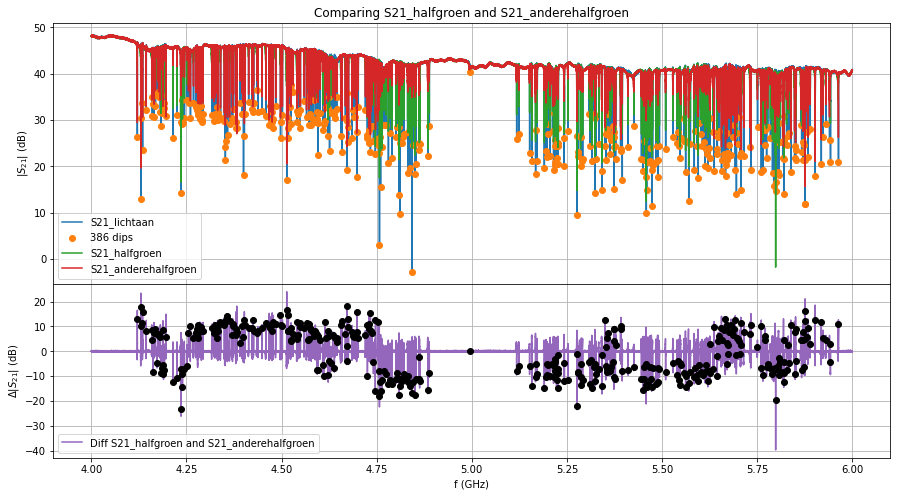

In [23]:
fig,axs = plt.subplots(2, 1, sharex=True, figsize=(15,8),
                       gridspec_kw={'height_ratios': [3, 2], 'hspace': 0})
fig.subplots_adjust(hspace=0)

m = 5.635
dm = 0.05
xbot = m - 0.5*dm
xtop = m + 0.5*dm
   
# S21_lichtaan
axs[0].plot(plots[0][0][1], plots[0][1][1], label = '%s' % plots[0][2])
dips0,_ = sg.find_peaks(-plots[0][1][1], distance = 4, prominence = 2)
axs[0].plot(plots[0][0][1][dips0], plots[0][1][1][dips0], 'o', label = '%s dips' % len(dips0))

# S21_halfgroen
axs[0].plot(plots[1][0][1], plots[1][1][1], label = '%s' % plots[1][2])
dips1,_ = sg.find_peaks(-plots[1][1][1], distance = 4, prominence = 2)
#axs[0].plot(plots[1][0][1][dips1], plots[1][1][1][dips1], 'o', label = '%s dips' % len(dips1))

# S21_anderehalfgroen
axs[0].plot(plots[2][0][1], plots[2][1][1], label = '%s' % plots[2][2])
dips2,_ = sg.find_peaks(-plots[2][1][1], distance = 4, prominence = 2)
#axs[0].plot(plots[2][0][1][dips2], plots[2][1][1][dips2], 'o', label = '%s dips' % len(dips2))

# Difference between S21_halfgroen and S21_anderehalfgroen
diff = plotdiffs21(plots[1], plots[2])
axs[1].plot(diff[0][1], diff[1][1], c = colorcycle[4], label = '%s' % diff[2])
axs[1].plot(diff[0][1][dips0-10], diff[1][1][dips0-4], 'o', c = 'k')
        
#axs[0].set_xlim(xbot,xtop)
axs[0].set_ylabel('%s' % plots[0][1][0])
axs[0].set_title('Comparing %s and %s' % (plots[1][2], plots[2][2]))
axs[0].grid()
axs[0].legend()
    
#axs[1].set_xlim(xbot,xtop)
axs[1].set_xlabel('%s' % plots[0][0][0])
axs[1].set_ylabel('$\Delta$%s' % plots[0][1][0])
axs[1].grid()
axs[1].legend()

plt.show()

In [24]:
fig = make_subplots(rows = 5, cols = 1,
                    shared_xaxes = True,
                    vertical_spacing = 0, 
                    specs=[[{'rowspan':3}],
                           [None],
                           [None],
                           [{'rowspan':2}],
                           [None]])

x0 = plotS21_lichtaan[0][1]
y0 = plotS21_lichtaan[1][1]
x1 = plotS21_halfgroen[0][1]
y1 = plotS21_halfgroen[1][1]
x2 = plotS21_anderehalfgroen[0][1]
y2 = plotS21_anderehalfgroen[1][1]
x12 = plotdiffs21(plotS21_halfgroen, plotS21_anderehalfgroen)[0][1]
y12 = plotdiffs21(plotS21_halfgroen, plotS21_anderehalfgroen)[1][1]

dips0,_ = sg.find_peaks(-y0, distance = 4, prominence = 2)
dips1,_ = sg.find_peaks(-y1, distance = 4, prominence = 2)
dips2,_ = sg.find_peaks(-y2, distance = 4, prominence = 2)

colorcycle = [u'#1f77b4', u'#ff7f0e', u'#2ca02c', u'#d62728', u'#9467bd', 
              u'#8c564b', u'#e377c2', u'#7f7f7f', u'#bcbd22', u'#17becf']

# S21_lichtaan with dip detection
fig.add_trace(go.Scatter(x = x0, 
                         y = y0, 
                         marker = dict(color = colorcycle[0]),
                         name = '%s' % plotS21_lichtaan[2]), 
              row = 1, 
              col = 1)
fig.add_trace(go.Scatter(x = x0[dips0], 
                         y = y0[dips0], 
                         marker = dict(symbol = "0", 
                                       color = colorcycle[1]),
                         mode = "markers",
                         name = '%s dips' % len(dips0)), 
              row = 1, 
              col = 1)

# S21_halfgroen with dip detection
fig.add_trace(go.Scatter(x = x1, 
                         y = y1, 
                         marker = dict(color = colorcycle[2]),
                         name = '%s' % plotS21_halfgroen[2]), 
              row = 1, 
              col = 1)
#fig.add_trace(go.Scatter(x = x1[dips1], 
#                         y = y1[dips1],
#                         marker = dict(symbol = "0", 
#                                       color = colorcycle[3]),
#                         mode = "markers",
#                         name = '%s dips' % len(dips1)), 
#              row = 1, 
#              col = 1)

# S21_anderehalfgroen with dip detection
fig.add_trace(go.Scatter(x = x2, 
                         y = y2,
                         marker = dict(color = colorcycle[3]),
                         name = '%s' % plotS21_anderehalfgroen[2]), 
              row = 1, 
              col = 1)
#fig.add_trace(go.Scatter(x = x2[dips2], 
#                         y = y2[dips2],
#                         marker = dict(symbol = "0", 
#                                       color = colorcycle[5]),
#                         mode = "markers",
#                         name = '%s dips' % len(dips2)), 
#              row = 1, 
#              col = 1)

# Difference between S21_halfgroen and S21_anderehalfgroen
fig.add_trace(go.Scatter(x = x12, 
                         y = y12,
                         marker = dict(color = colorcycle[4]),
                         name = 'Diff %s and %s' % (plotS21_halfgroen[2], plotS21_anderehalfgroen[2])), 
              row = 4, 
              col = 1)
fig.add_trace(go.Scatter(x = x12[dips0-4], 
                         y = y12[dips0-4],
                         marker = dict(symbol = "0", 
                                       color = 'black'),
                         mode = "markers",
                         name = '%s dips' % len(dips0)), 
              row = 4, 
              col = 1)

fig.update_xaxes(title = 'f (GHz)')
fig.update_yaxes(title = '|S$_{21}$| (dB)')
fig.show()



fig.write_html("/Users/gabriellomans/Desktop/Uni/TUD/BEP/Figures_Code/plotcompare_S21_halfgroen.html")